#***Fish***

# Khai báo thư viện 


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import seaborn as sns

from collections import Counter


# Tải và kiểm tra dữ liệu

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [4]:
fish = pd.read_csv('./fish.csv')
type(fish)
fish.describe

<bound method NDFrame.describe of     Species  Weight  Length1  Length2  Length3   Height   Width
0     Bream   242.0     23.2     25.4     30.0  11.5200  4.0200
1     Bream   290.0     24.0     26.3     31.2  12.4800  4.3056
2     Bream   340.0     23.9     26.5     31.1  12.3778  4.6961
3     Bream   363.0     26.3     29.0     33.5  12.7300  4.4555
4     Bream   430.0     26.5     29.0     34.0  12.4440  5.1340
..      ...     ...      ...      ...      ...      ...     ...
154   Smelt    12.2     11.5     12.2     13.4   2.0904  1.3936
155   Smelt    13.4     11.7     12.4     13.5   2.4300  1.2690
156   Smelt    12.2     12.1     13.0     13.8   2.2770  1.2558
157   Smelt    19.7     13.2     14.3     15.2   2.8728  2.0672
158   Smelt    19.9     13.8     15.0     16.2   2.9322  1.8792

[159 rows x 7 columns]>

In [5]:
fish.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159 entries, 0 to 158
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Species  159 non-null    object 
 1   Weight   159 non-null    float64
 2   Length1  159 non-null    float64
 3   Length2  159 non-null    float64
 4   Length3  159 non-null    float64
 5   Height   159 non-null    float64
 6   Width    159 non-null    float64
dtypes: float64(6), object(1)
memory usage: 8.8+ KB


In [6]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), fish.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [7]:
fish.style.background_gradient(cmap='viridis')

,Species,Weight,Length1,Length2,Length3,Height,Width
0,Bream,242.000000,23.200000,25.400000,30.000000,11.520000,4.020000
1,Bream,290.000000,24.000000,26.300000,31.200000,12.480000,4.305600
2,Bream,340.000000,23.900000,26.500000,31.100000,12.377800,4.696100
3,Bream,363.000000,26.300000,29.000000,33.500000,12.730000,4.455500
4,Bream,430.000000,26.500000,29.000000,34.000000,12.444000,5.134000
5,Bream,450.000000,26.800000,29.700000,34.700000,13.602400,4.927400
6,Bream,500.000000,26.800000,29.700000,34.500000,14.179500,5.278500
7,Bream,390.000000,27.600000,30.000000,35.000000,12.670000,4.690000
8,Bream,450.000000,27.600000,30.000000,35.100000,14.004900,4.843800
9,Bream,500.000000,28.500000,30.700000,36.200000,14.226600,4.959400


#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [8]:
a= []
for c in fish :
  a.append(c)
print(a)

['Species', 'Weight', 'Length1', 'Length2', 'Length3', 'Height', 'Width']


Quan sát thuộc tính Species

In [9]:
sp = fish['Species'].value_counts()
sp = pd.DataFrame(sp)
sp

,Species
Perch,56
Bream,35
Roach,20
Pike,17
Smelt,14
Parkki,11
Whitefish,6


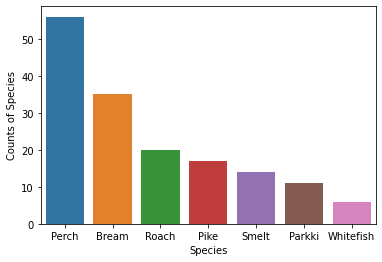

In [10]:
sns.barplot(x=sp.index, y=sp['Species']);
plt.xlabel('Species')
plt.ylabel('Counts of Species')
plt.show()

Mô tả mối liên hệ giữa các thuộc tính của bảng

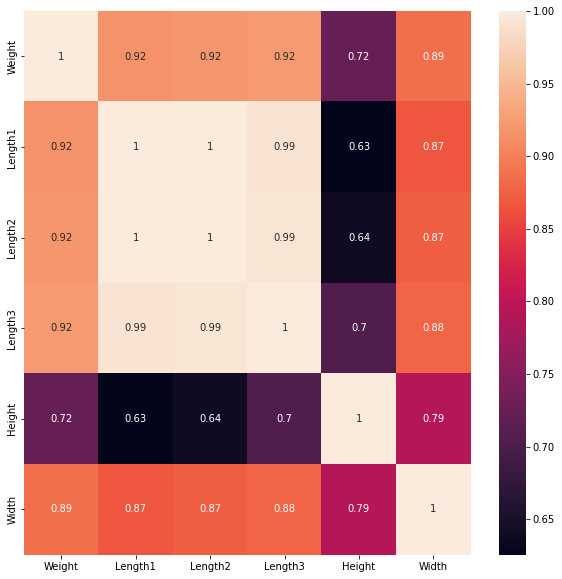

In [11]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(fish[["Weight", "Length1", "Length2", "Length3", "Height", "Width",]].corr(), annot = True)
plt.show()

Qua đây ta thấy Length1, Length2, Length3 là 3 thuộc tính các tương quan với Weight cao nhất 

In [12]:
def corr(species):
    fish1 = fish[fish['Species'] == species]
    fig, ax = plt.subplots(figsize=(5,5)) 
    sns.heatmap(fish1[["Weight", "Length1", "Length2", "Length3", "Height", "Width"]].corr(), annot = True)
    plt.title("Correlation heat map of {} ".format(species))
    plt.show()

Bây giờ ta sẽ xem sự tương quan giữa các thuộc tính trong từng loài

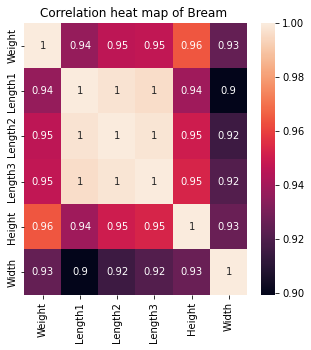

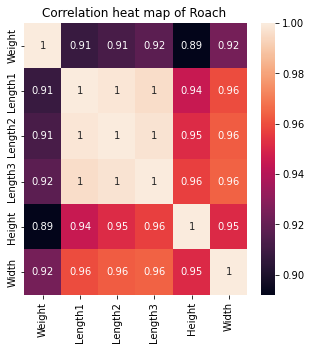

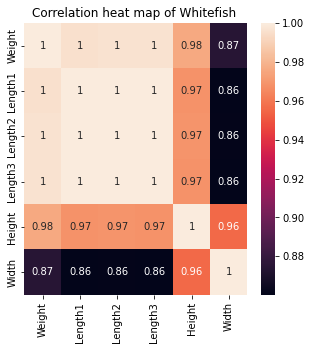

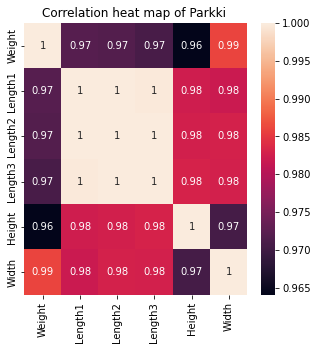

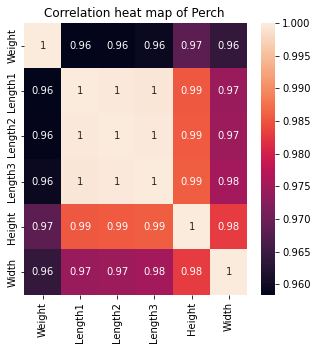

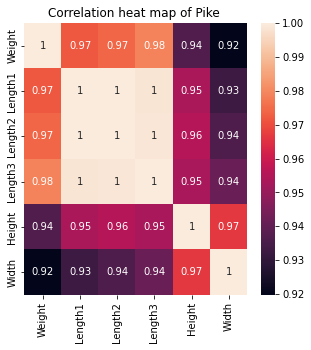

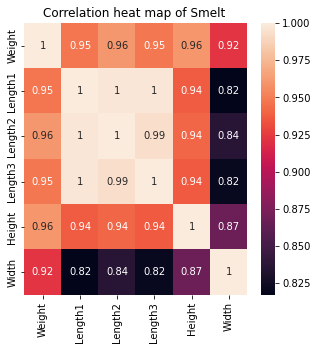

In [13]:
species_list = list(fish['Species'].unique())
for s in species_list:
    corr(s)

Qua đây ta có thể thấy các thuộc tính còn có sự tương quan rất cao với Weight

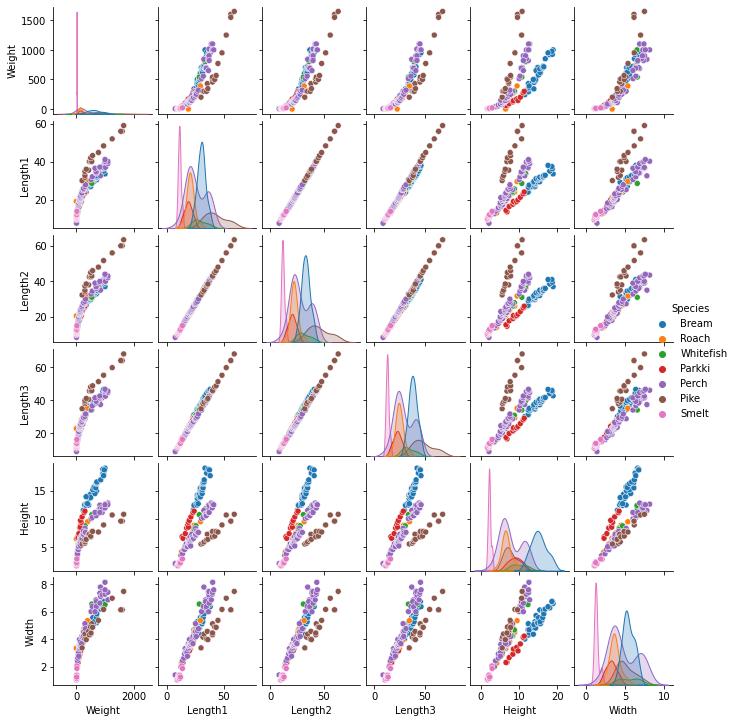

In [14]:
g = sns.pairplot(fish, kind='scatter', hue='Species')
g.fig.set_size_inches(10,10)

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biết với phần còn lại của dữ liệu

In [15]:
def detect_outliers(df,features):
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
        
    
    outlier_indices = Counter(outlier_indices)
    multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    
    return multiple_outliers

In [16]:
fish.loc[detect_outliers(fish,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
142,Pike,1600.0,56.0,60.0,64.0,9.600,6.144
143,Pike,1550.0,56.0,60.0,64.0,9.600,6.144
144,Pike,1650.0,59.0,63.4,68.0,10.812,7.480


Điều nay cho thấy ở Loài Pike có 3 cá thể rất khác biết với toàn thể chung.
Nhưng điều này có phải là khác biệt lớn so với loài của nó không thì chưa rõ, ta cần tìm sự khác biệt trong từng loài

In [17]:
df_pike = fish[fish['Species'] == 'Pike']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


Thấy rằng ở loài Pike không có cá thể khác biệt nào, nên không phải loại bỏ dữ liệu nào

In [18]:
print(fish['Species'].unique())

['Bream' 'Roach' 'Whitefish' 'Parkki' 'Perch' 'Pike' 'Smelt']


In [19]:
df_pike = fish[fish['Species'] == 'Bream']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [20]:
df_pike = fish[fish['Species'] == 'Roach']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
54,Roach,390.0,29.5,31.7,35.0,9.4850,5.355
35,Roach,40.0,12.9,14.1,16.2,4.1472,2.268


Cần loại bỏ 2 dòng dữ liệu 54 và 35 rất khác biệt ở loài Roach

In [21]:
df_pike = fish[fish['Species'] == 'Whitefish']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [22]:
df_pike = fish[fish['Species'] == 'Parkki']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [23]:
df_pike = fish[fish['Species'] == 'Perch']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [24]:
df_pike = fish[fish['Species'] == 'Smelt']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
157,Smelt,19.7,13.2,14.3,15.2,2.8728,2.0672
158,Smelt,19.9,13.8,15.0,16.2,2.9322,1.8792


Cần loại bỏ 2 dòng dữ liệu 157 và 158 rất khác biệt ở loài Smelt

Tiến hành loại bỏ các dòng dữ liệu "nhiễu" trong bảng dữ liệu

In [25]:
fish1 = fish.drop([35, 54, 157,158])
fish1.info()
fish = fish1

<class 'pandas.core.frame.DataFrame'>
Int64Index: 155 entries, 0 to 156
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Species  155 non-null    object 
 1   Weight   155 non-null    float64
 2   Length1  155 non-null    float64
 3   Length2  155 non-null    float64
 4   Length3  155 non-null    float64
 5   Height   155 non-null    float64
 6   Width    155 non-null    float64
dtypes: float64(6), object(1)
memory usage: 9.7+ KB


In [26]:
fish_feature_names = ["Bias" ,"Species", "Length1", "Length2", "Length3", "Height", "Width"]
#fish_feature_names = fish.columns[2:].values.tolist()
print(type(fish_feature_names))
print(fish_feature_names)

<class 'list'>
['Bias', 'Species', 'Length1', 'Length2', 'Length3', 'Height', 'Width']


In [27]:
countNULL = fish.isna().sum()
print(countNULL)
null_columns = countNULL[countNULL > 0]
print(null_columns)

Species    0
Weight     0
Length1    0
Length2    0
Length3    0
Height     0
Width      0
dtype: int64
Series([], dtype: int64)


In [28]:
print(fish['Species'].unique())
fish['Species'] = LabelEncoder().fit_transform(fish['Species'])
#X.describe
print(fish)

['Bream' 'Roach' 'Whitefish' 'Parkki' 'Perch' 'Pike' 'Smelt']
     Species  Weight  Length1  Length2  Length3   Height   Width
0          0   242.0     23.2     25.4     30.0  11.5200  4.0200
1          0   290.0     24.0     26.3     31.2  12.4800  4.3056
2          0   340.0     23.9     26.5     31.1  12.3778  4.6961
3          0   363.0     26.3     29.0     33.5  12.7300  4.4555
4          0   430.0     26.5     29.0     34.0  12.4440  5.1340
..       ...     ...      ...      ...      ...      ...     ...
152        5     9.9     11.3     11.8     13.1   2.2139  1.1659
153        5     9.8     11.4     12.0     13.2   2.2044  1.1484
154        5    12.2     11.5     12.2     13.4   2.0904  1.3936
155        5    13.4     11.7     12.4     13.5   2.4300  1.2690
156        5    12.2     12.1     13.0     13.8   2.2770  1.2558

[155 rows x 7 columns]


# Tiến hành train dữ liệu

In [29]:
X = fish.drop(columns=['Weight'])
y = fish['Weight']
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)

X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]

#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)
#print(X_train)

[[ 1.         -0.13018891  0.60505177  0.59261387  0.50463186  0.54449589
   1.90638841]
 [ 1.         -0.13018891  0.55371174  0.54475095  0.43371417  0.25739589
   1.08635357]
 [ 1.          1.62736139 -1.6641776  -1.70480635 -1.73813992 -1.62114095
  -1.82965586]
 [ 1.         -0.13018891  1.06711205  1.07124309  0.9567321   0.75247384
   1.71229836]
 [ 1.         -0.13018891 -0.60657296 -0.58481399 -0.65664523 -0.7455081
  -0.51941698]
 [ 1.          1.62736139 -1.57176554 -1.62822568 -1.64062811 -1.61696927
  -1.88567585]
 [ 1.         -0.13018891  1.01577202  0.97551725  0.86808499  0.46250727
   1.73035054]
 [ 1.         -1.30188911 -0.27799676 -0.22105579 -0.0449802   0.75177468
   0.10140332]
 [ 1.         -1.30188911  0.55371174  0.59261387  0.79716731  1.68026432
   0.91311087]
 [ 1.          0.45566119  3.01803323  2.98575994  2.87150959  0.10439553
   0.9445566 ]
 [ 1.         -0.13018891  0.8206799   0.78406556  0.68192607  0.33085471
   1.07418291]
 [ 1.         -0.13018

In [30]:
#Cách 1:
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X_train,y_train)
print(beta1)

[ 418.16388889   65.00476173  729.91763134   28.31946977 -585.74071096
  234.29932548    7.94951873]


In [31]:
#Cách 2:
Xt = np.transpose(X_train)
XtX = np.dot(Xt,X_train)
Xty = np.dot(Xt,y_train)
beta2 = np.linalg.solve(XtX,Xty)
print(beta2)

[ 418.16388889   65.00476173  729.91763134   28.31946977 -585.74071096
  234.29932548    7.94951873]


In [32]:
# Cách 3: Kiểm chứng
from sklearn.linear_model import LinearRegression
reg = LinearRegression(fit_intercept=False).fit(X_train, y_train)
beta3 = reg.coef_
print(beta3)


[ 418.16388889   65.00476173  729.91763134   28.31946977 -585.74071096
  234.29932548    7.94951873]


In [33]:
y_pred1 = np.dot(X_test,beta1)
print(y_pred1)

[ 566.92526408  653.24127297  -88.09293969  383.06196489  366.57024751
  680.05304771   22.62603939  277.58892497  172.87612676  -48.38408547
  958.69863519  319.7911749   280.907769    951.77080979  633.08311737
  143.72382043  364.53807495  234.10056337  749.65146631 -264.66668803
  110.24441022  749.46865601  348.89877041  478.50696026  360.35975345
  732.6525481  1095.49895757  104.16429506  303.15237177  137.84970349
 1196.75903341  689.62929533  443.19221026  638.89426307 1004.43190313
  322.15037614  395.63966046  210.29452153   86.84847235  547.52839486
   85.90651062  220.29512145  257.45796896  669.67545202  655.13147269
  419.44816641   31.55892234]


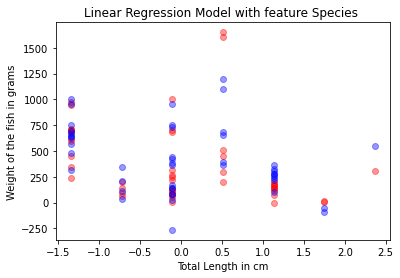

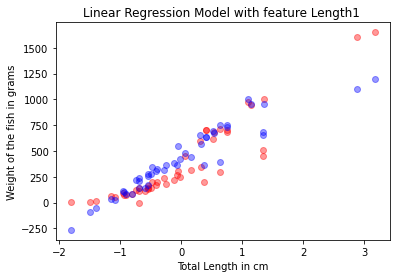

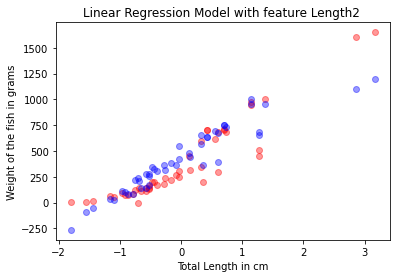

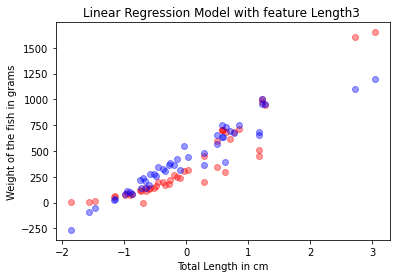

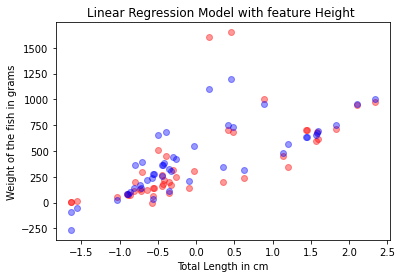

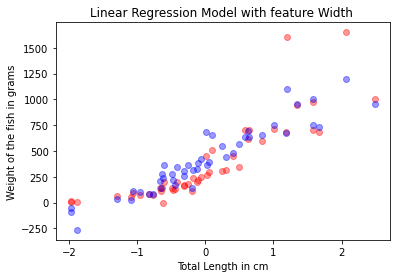

In [34]:
X_test = pd.DataFrame(X_test, columns = fish_feature_names)
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred1, color='blue', alpha=0.4) #Predicted data
  #plt.plot(X_test[feature], y_pred,color= "black")
  plt.title("Linear Regression Model with feature {} ".format(feature))
  plt.xlabel('Total Length in cm')
  plt.ylabel('Weight of the fish in grams')
  plt.show();


for feature in fish_feature_names :
  if feature != "Bias":
    visualize_result(feature)

In [35]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred1)

0.8396552923801808

In [36]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_pred1,y_test)

23167.666194801288

### ***Insurance***

# Khai báo thư viện 


In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import seaborn as sns

from collections import Counter


# Tải và kiểm tra dữ liệu

In [38]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [39]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [40]:
insurance = pd.read_csv('./insurance.csv')
insurance1 = insurance
type(insurance)
insurance.describe

<bound method NDFrame.describe of       age     sex     bmi  children smoker     region      charges
0      19  female  27.900         0    yes  southwest  16884.92400
1      18    male  33.770         1     no  southeast   1725.55230
2      28    male  33.000         3     no  southeast   4449.46200
3      33    male  22.705         0     no  northwest  21984.47061
4      32    male  28.880         0     no  northwest   3866.85520
...   ...     ...     ...       ...    ...        ...          ...
1333   50    male  30.970         3     no  northwest  10600.54830
1334   18  female  31.920         0     no  northeast   2205.98080
1335   18  female  36.850         0     no  southeast   1629.83350
1336   21  female  25.800         0     no  southwest   2007.94500
1337   61  female  29.070         0    yes  northwest  29141.36030

[1338 rows x 7 columns]>

In [41]:
insurance.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [42]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), insurance.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [43]:
insurance.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [44]:
a= []
for c in insurance :
  a.append(c)
print(a)

['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges']


In [45]:
print(insurance['sex'].unique())
insurance['sex'] = LabelEncoder().fit_transform(insurance['sex']) # nữ :0 , nam : 1
print(insurance['smoker'].unique())
insurance['smoker'] = LabelEncoder().fit_transform(insurance['smoker']) # yes : 1, no : 0

['female' 'male']
['yes' 'no']


Quan sát thuộc tính Species

In [46]:
sp = insurance['region'].value_counts()
sp = pd.DataFrame(sp)
sp

,region
southeast,364
southwest,325
northwest,325
northeast,324


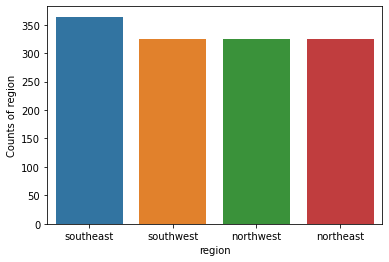

In [47]:
sns.barplot(x=sp.index, y=sp['region']);
plt.xlabel('region')
plt.ylabel('Counts of region')
plt.show()

Mô tả mối liên hệ giữa các thuộc tính của bảng

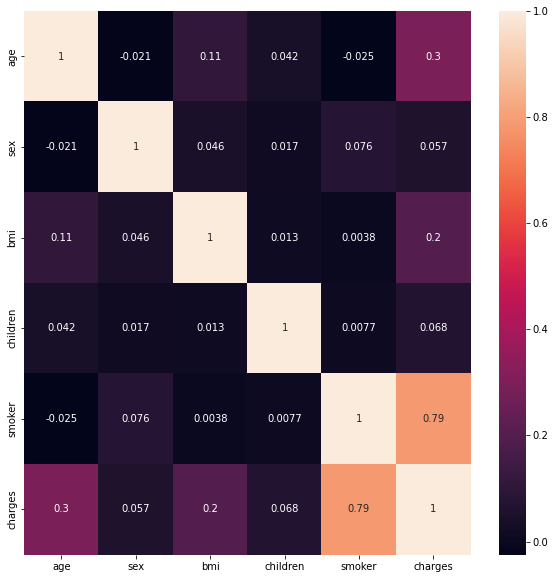

In [48]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(insurance[["age", "sex", "bmi", "children", "smoker", "region","charges"]].corr(), annot = True)
plt.show()

Qua đây ta thấy smoker là dữ liệu có tương quan cao nhất với charges. Các dữ liệu còn lại cho dữ kiện liên quan rất thấp

In [49]:
def corr(region):
    insurance1 = insurance[insurance['region'] == region]
    fig, ax = plt.subplots(figsize=(5,5)) 
    sns.heatmap(insurance1[["age", "sex", "bmi", "children", "smoker", "region","charges"]].corr(), annot = True)
    plt.title("Correlation heat map of {} ".format(region))
    plt.show()

Bây giờ ta sẽ xem sự tương quan giữa các thuộc tính trong từng loài

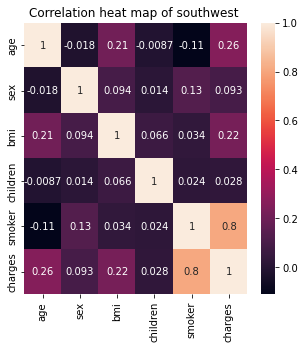

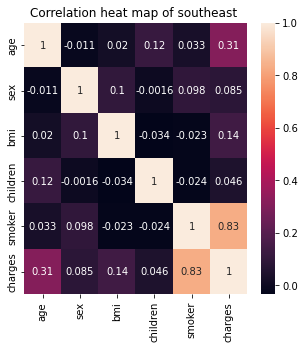

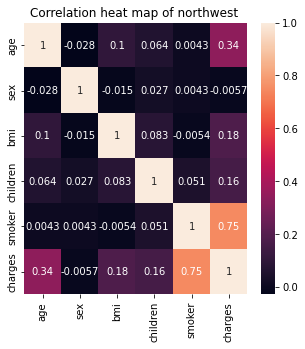

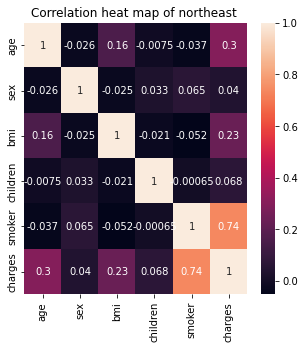

In [50]:
region_list = list(insurance['region'].unique())
for s in region_list:
    corr(s)

Qua đây ta có thể thấy các thuộc tính smoker, age, và bmi có sự tương quan ở mức tạm chấp nhận được

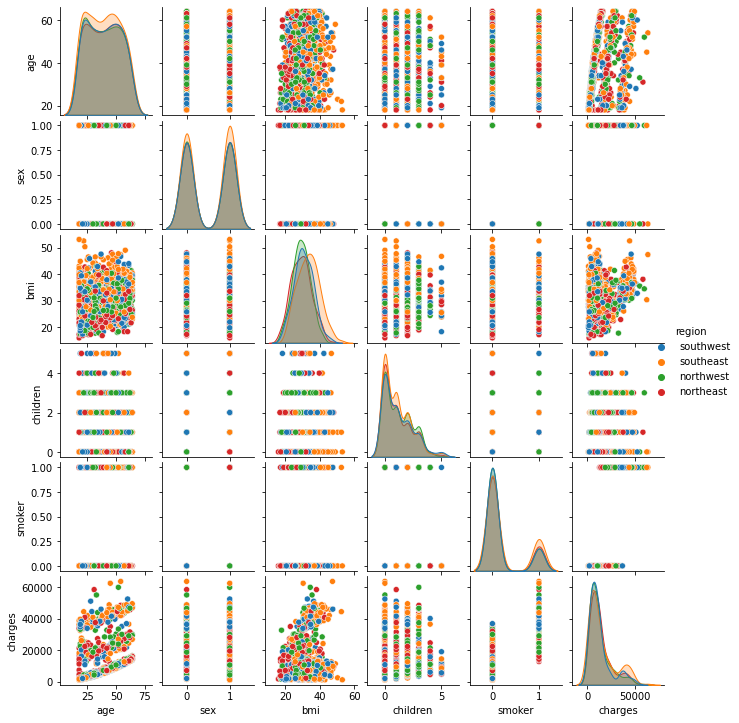

In [51]:
g = sns.pairplot(insurance, kind='scatter', hue='region')
g.fig.set_size_inches(10,10)

Giờ ta sẽ xem tương quan của region với charges

In [52]:
print(insurance['region'].unique())
insurance['region'] = LabelEncoder().fit_transform(insurance['region']) 
print(insurance['region'].unique())


['southwest' 'southeast' 'northwest' 'northeast']
[3 2 1 0]


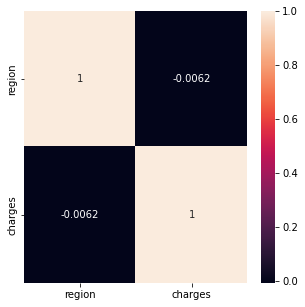

In [53]:
fig, ax = plt.subplots(figsize=(5,5)) 
sns.heatmap(insurance[["region","charges"]].corr(), annot = True)
plt.show()

Qua đây cũng thấy region có tương quan rất thấp với charges
Sau khi quan sát dữ liệu, ta sẽ sử dụng 3 trường dữ liệu là age, bmi, smoker để dự đoán cho charges

---



Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [54]:
def detect_outliers(df,features,redetect=False):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        if redetect == False:
          outlier_step = IQR * 1.5
        else:
            outlier_step = IQR * 1
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [55]:
x = detect_outliers(insurance,["age", "bmi", "smoker", "region","charges"])
new_insurance = insurance.loc[x]
print(new_insurance.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3 entries, 543 to 1047
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       3 non-null      int64  
 1   sex       3 non-null      int64  
 2   bmi       3 non-null      float64
 3   children  3 non-null      int64  
 4   smoker    3 non-null      int64  
 5   region    3 non-null      int64  
 6   charges   3 non-null      float64
dtypes: float64(2), int64(5)
memory usage: 192.0 bytes
None


In [56]:
new_insurance.style.background_gradient(cmap='viridis')

,age,sex,bmi,children,smoker,region,charges
543,54,0,47.410000,0,1,2,63770.428010
860,37,0,47.600000,2,1,3,46113.511000
1047,22,1,52.580000,1,1,2,44501.398200


Ta sẽ loại bỏ 3 dữ liệu này

In [57]:
insurance = insurance.drop(x)

In [58]:
insurane_feature_names = ['bias','age','bmi','smoker']
#fish_feature_names = fish.columns[2:].values.tolist()
print(type(insurane_feature_names))
print(insurane_feature_names)

<class 'list'>
['bias', 'age', 'bmi', 'smoker']


#Tiến hành train dữ liệu

In [59]:
X = insurance.drop(columns=['charges','sex','children','region'])
y = insurance['charges']
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1))*2, X_train]
X_test = np.c_[np.ones((len(X_test), 1))*2, X_test]

X_train = pd.DataFrame(X_train, columns = insurane_feature_names)
X_test = pd.DataFrame(X_test, columns = insurane_feature_names)
#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)
#print(X_train)
#print(X_test)

     bias       age       bmi    smoker
0     2.0 -0.349546 -0.661760 -0.512018
1     2.0  1.289606 -1.763496 -0.512018
2     2.0 -0.990954  2.463980  1.953057
3     2.0 -1.276024  0.051128 -0.512018
4     2.0 -0.848419 -1.535837 -0.512018
..    ...       ...       ...       ...
929   2.0 -0.135744 -0.178193 -0.512018
930   2.0  0.933268  0.342764 -0.512018
931   2.0 -1.489826 -0.051900 -0.512018
932   2.0  1.218338  1.513462 -0.512018
933   2.0  1.218338  0.484843  1.953057

[934 rows x 4 columns]
     bias       age       bmi    smoker
0     2.0 -0.279082 -0.251794 -0.487498
1     2.0 -1.061683 -0.116915  2.051290
2     2.0 -0.563664  1.107687 -0.487498
3     2.0 -0.350228  0.896322 -0.487498
4     2.0  1.286120  1.076435  2.051290
..    ...       ...       ...       ...
396   2.0  1.214974 -1.345629 -0.487498
397   2.0 -1.132828  1.601969  2.051290
398   2.0  1.712993 -1.220619  2.051290
399   2.0 -0.634810  0.654527  2.051290
400   2.0  0.005500 -0.876842 -0.487498

[401 rows x 4 c

In [60]:
X1 = X_train.to_numpy()
X2 = X_test.to_numpy()
y1 = y_train.to_numpy()
y2 = y_test.to_numpy()
#print(X1)

[[ 2.         -0.34954639 -0.66176008 -0.51201774]
 [ 2.          1.28960567 -1.76349616 -0.51201774]
 [ 2.         -0.99095372  2.46397984  1.95305734]
 ...
 [ 2.         -1.48982608 -0.05190013 -0.51201774]
 [ 2.          1.21833818  1.51346244 -0.51201774]
 [ 2.          1.21833818  0.48484308  1.95305734]]


In [61]:
#Cách 1:
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X1,y1)
print(beta1)

[6645.55143942 3596.87997352 2074.90019879 9644.46061251]


In [62]:
#Cách 2:
Xt = np.transpose(X1)
XtX = np.dot(Xt,X1)
Xty = np.dot(Xt,y1)
beta2 = np.linalg.solve(XtX,Xty)
print(beta2)

[6645.55143942 3596.87997352 2074.90019879 9644.46061251]


In [63]:
# Cách 3: Kiểm chứng
from sklearn.linear_model import LinearRegression
reg = LinearRegression(fit_intercept=False).fit(X_train, y_train)
beta3 = reg.coef_
print(beta3)


[6645.55143942 3596.87997352 2074.90019879 9644.46061251]


In [64]:
y_pred1 = np.dot(X2,beta1)
#print(y_pred1)
#print(len(y_pred1))

[ 7063.1761974  29013.35983934  8860.35515315  9189.49945516
 39934.20460581 29184.41324515  8076.61298075 38068.69923147
 15549.70915415  4582.92546549  8749.16365768 14097.64303836
  6808.37037068 38908.4834824  12998.74736906  9612.29588354
  9561.30538318 11178.49170619 26624.58005008 33179.0554959
 11994.73557249  2400.15322747  4845.78889872  9917.48185802
 16663.62392404 11778.6248649   3286.0120345  -1068.68329869
  5186.1324695  37809.31654527 32595.71571977 10159.46080903
 11095.14618702  4254.80945897  3495.56814974 33091.06530028
 30324.4107505  13290.55289103  4453.23412239  4035.21800435
  1060.3747196  12163.81124543  9102.33410417  9233.12155971
 11742.37115616  5708.37858893  8196.40461838 26396.11718548
 10607.71857911 15996.93862874  4698.49036957  2787.38515782
  6315.25874969  3299.93502264  3176.59482102 40142.66460861
 32204.11038081  1289.51575375 16337.89255212  3296.45427561
  5992.2621383  15860.01452375 14969.37540638 12683.25478738
  7643.30649431 13348.437

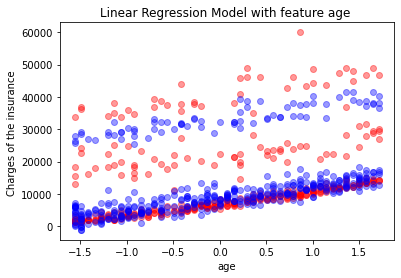

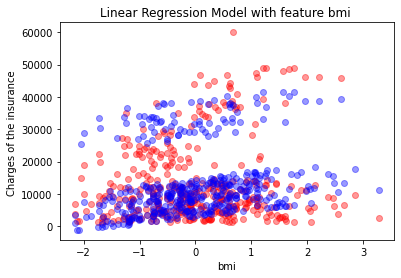

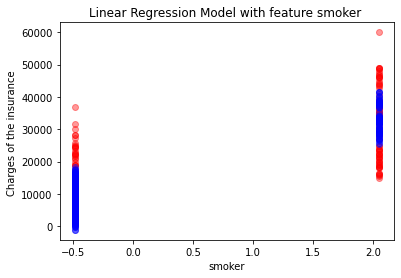

In [65]:
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred1, color='blue', alpha=0.4) #Predicted data
  #plt.plot(X_test[feature], y_pred,color= "black")
  plt.title("Linear Regression Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Charges of the insurance ')
  plt.show();


for feature in insurane_feature_names :
   if feature != "bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [66]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred1)

0.7337690311619574

In [67]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_pred1,y_test)

37133551.14432188

# ***Wine***

# Khai báo thư viện 


In [68]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go

from collections import Counter


# Tải và kiểm tra dữ liệu

In [69]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [70]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [71]:
wine = pd.read_csv('./wine.csv')
type(wine)
wine.describe

<bound method NDFrame.describe of       fixed acidity  volatile acidity  citric acid  ...  sulphates  alcohol  quality
0               7.4             0.700         0.00  ...       0.56      9.4        5
1               7.8             0.880         0.00  ...       0.68      9.8        5
2               7.8             0.760         0.04  ...       0.65      9.8        5
3              11.2             0.280         0.56  ...       0.58      9.8        6
4               7.4             0.700         0.00  ...       0.56      9.4        5
...             ...               ...          ...  ...        ...      ...      ...
1594            6.2             0.600         0.08  ...       0.58     10.5        5
1595            5.9             0.550         0.10  ...       0.76     11.2        6
1596            6.3             0.510         0.13  ...       0.75     11.0        6
1597            5.9             0.645         0.12  ...       0.71     10.2        5
1598            6.0            

In [72]:
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [73]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), wine.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [74]:
wine.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [75]:
a= []
for c in wine :
  a.append(c)
print(a)

['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']


Mô tả mối liên hệ giữa các thuộc tính của bảng

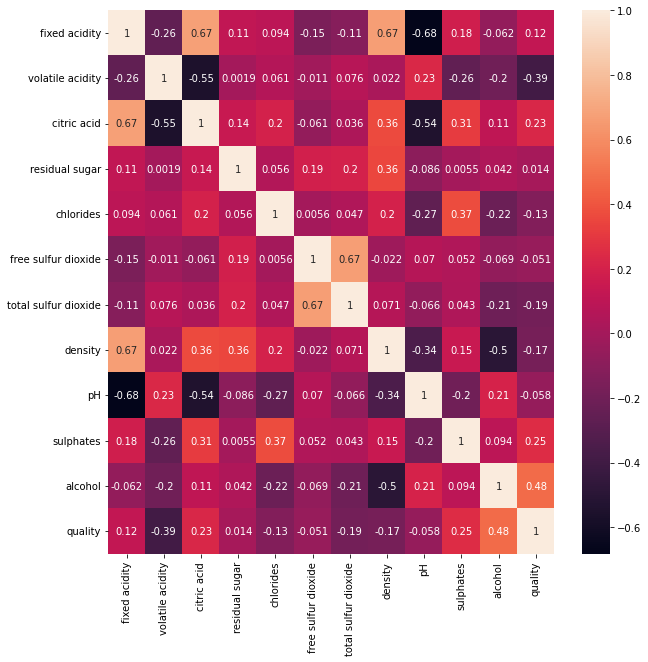

In [76]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(wine[['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']].corr(), annot = True)
plt.show()

Qua đây ta thấy alcohol là dữ liệu có tương quan cao nhất với quality.
Các dữ liệu còn lại có mối tương quan lẫn nhau. Residual sugar có tương quan thấp với quality nhưng lại đáng kể với density, total sulfur dioxide, free sulfur dioxide nên không thể loại trường dữ liệu này. Tương tự free sulfur dioxide cũng có tương quan đáng kể với total sulfur dioxide.

Qua đây ta có thể thấy các thuộc tính smoker, age, và bmi có sự tương quan ở mức tạm chấp nhận được

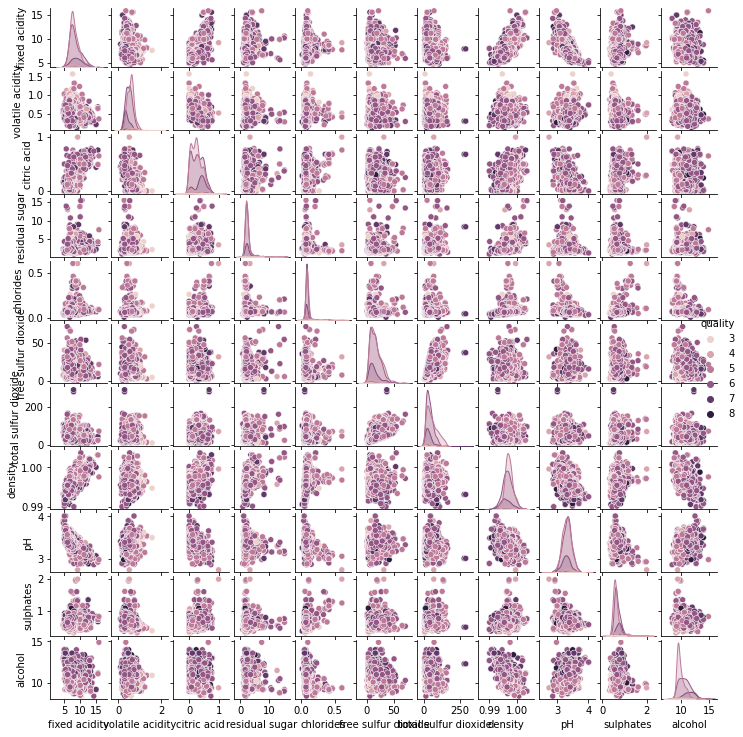

In [77]:
g = sns.pairplot(wine, kind='scatter', hue='quality')
g.fig.set_size_inches(10,10)

In [78]:
print(wine['quality'].unique())

[5 6 7 4 8 3]


In [79]:
sp = wine['quality'].value_counts()
sp = pd.DataFrame(sp)
sp

,quality
5,681
6,638
7,199
4,53
8,18
3,10


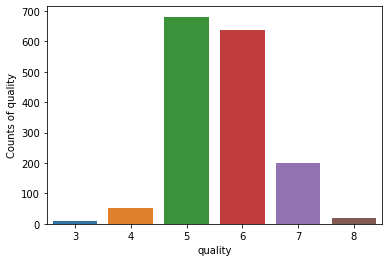

In [80]:
sns.barplot(x=sp.index, y=sp['quality']);
plt.xlabel('quality')
plt.ylabel('Counts of quality')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



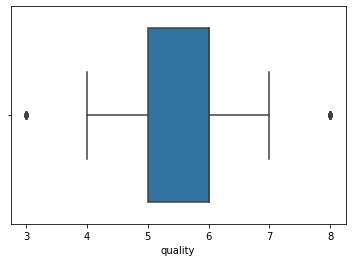

In [81]:
sns.boxplot(wine['quality'])

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [82]:
def detect_outliers(df,features,redetect=False):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        if redetect == False:
          outlier_step = IQR * 1.5
        else:
            outlier_step = IQR * 1
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [83]:
x = detect_outliers(wine,['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality'])
new_wine = wine.loc[x]
print(new_wine.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37 entries, 353 to 1270
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         37 non-null     float64
 1   volatile acidity      37 non-null     float64
 2   citric acid           37 non-null     float64
 3   residual sugar        37 non-null     float64
 4   chlorides             37 non-null     float64
 5   free sulfur dioxide   37 non-null     float64
 6   total sulfur dioxide  37 non-null     float64
 7   density               37 non-null     float64
 8   pH                    37 non-null     float64
 9   sulphates             37 non-null     float64
 10  alcohol               37 non-null     float64
 11  quality               37 non-null     int64  
dtypes: float64(11), int64(1)
memory usage: 3.8 KB
None


In [84]:
new_wine.style.background_gradient(cmap='viridis')

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
353,13.500000,0.530000,0.790000,4.800000,0.120000,23.000000,77.000000,1.001800,3.180000,0.770000,13.000000,5
364,12.800000,0.615000,0.660000,5.800000,0.083000,7.000000,42.000000,1.002200,3.070000,0.730000,10.000000,7
366,12.800000,0.615000,0.660000,5.800000,0.083000,7.000000,42.000000,1.002200,3.070000,0.730000,10.000000,7
374,14.000000,0.410000,0.630000,3.800000,0.089000,6.000000,47.000000,1.001400,3.010000,0.810000,10.800000,6
440,12.600000,0.310000,0.720000,2.200000,0.072000,6.000000,29.000000,0.998700,2.880000,0.820000,9.800000,8
442,15.600000,0.685000,0.760000,3.700000,0.100000,6.000000,43.000000,1.003200,2.950000,0.680000,11.200000,7
538,12.900000,0.350000,0.490000,5.800000,0.066000,5.000000,35.000000,1.001400,3.200000,0.660000,12.000000,7
554,15.500000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5
555,15.500000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5
557,15.600000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5


In [85]:
#wine = wine.drop(x)
print(len(x))

37


In [86]:
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [87]:
wine_feature_names = ['bias','fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
#fish_feature_names = fish.columns[2:].values.tolist()
print(len(wine_feature_names))
print(wine_feature_names)

12
['bias', 'fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']


#Tiến hành train dữ liệu

In [88]:
X = wine.drop(columns=['quality'])
y = wine['quality']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]

X_train = pd.DataFrame(X_train, columns = wine_feature_names)
X_test = pd.DataFrame(X_test, columns = wine_feature_names)
#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)
#print(X_train)
#print(X_test)

      bias  fixed acidity  volatile acidity  ...        pH  sulphates   alcohol
0      1.0       0.086490         -1.067418  ...  0.457419   0.006657  1.126283
1      1.0       1.150038          0.453481  ... -0.978350  -0.165247 -1.890506
2      1.0      -0.529248          0.791458  ...  0.522681  -0.680959 -0.853485
3      1.0       1.821753         -0.673111  ... -1.892022   0.579670 -0.476386
4      1.0       0.870157          0.566140  ... -1.435186  -0.509055 -0.947759
...    ...            ...               ...  ...       ...        ...       ...
1114   1.0       0.758205          0.115503  ... -1.108875  -0.279850 -0.947759
1115   1.0      -0.585224          0.678799  ...  0.522681  -1.082068 -0.382111
1116   1.0      -0.081438         -1.123747  ... -0.064679   0.579670  2.257579
1117   1.0       2.325538          0.397151  ... -0.390990   0.465068  1.409107
1118   1.0      -1.089010         -0.335133  ...  1.632139   0.407766  0.183536

[1119 rows x 12 columns]
     bias  fix

In [89]:
X1 = X_train.to_numpy()
X2 = X_test.to_numpy()
y1 = y_train.to_numpy()
y2 = y_test.to_numpy()
#print(X1)

[[ 1.          0.08649048 -1.06741755 ...  0.45741886  0.00665699
   1.12628301]
 [ 1.          1.15003829  0.45348068 ... -0.97835029 -0.16524699
  -1.89050586]
 [ 1.         -0.52924772  0.79145806 ...  0.52268109 -0.68095893
  -0.85348469]
 ...
 [ 1.         -0.08143812 -1.12374711 ... -0.06467901  0.57967026
   2.25757884]
 [ 1.          2.32553849  0.39715111 ... -0.39099019  0.46506761
   1.40910697]
 [ 1.         -1.08900972 -0.33513322 ...  1.63213907  0.40776628
   0.18353649]]


In [90]:
#Cách 1:
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X1,y1)
print(beta1)

[ 5.63896336  0.03481468 -0.22698663 -0.01957393  0.01935675 -0.06934222
  0.06051878 -0.1111277  -0.04491325 -0.04567678  0.13532317  0.26254942]


In [91]:
#Cách 2:
Xt = np.transpose(X1)
XtX = np.dot(Xt,X1)
Xty = np.dot(Xt,y1)
beta2 = np.linalg.solve(XtX,Xty)
print(beta2)

[ 5.63896336  0.03481468 -0.22698663 -0.01957393  0.01935675 -0.06934222
  0.06051878 -0.1111277  -0.04491325 -0.04567678  0.13532317  0.26254942]


In [92]:
# Cách 3: Kiểm chứng
from sklearn.linear_model import LinearRegression
reg = LinearRegression(fit_intercept=False).fit(X_train, y_train)
beta3 = reg.coef_
print(beta3)


[ 5.63896336  0.03481468 -0.22698663 -0.01957393  0.01935675 -0.06934222
  0.06051878 -0.1111277  -0.04491325 -0.04567678  0.13532317  0.26254942]


In [126]:
y_pred1 = np.dot(X2,beta1)
#print(y_pred1)

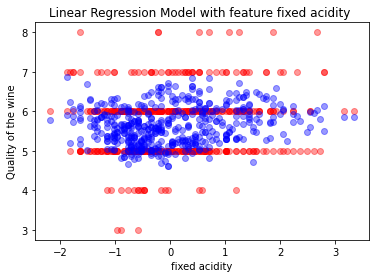

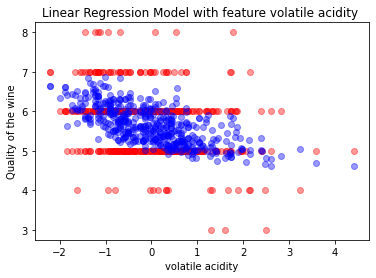

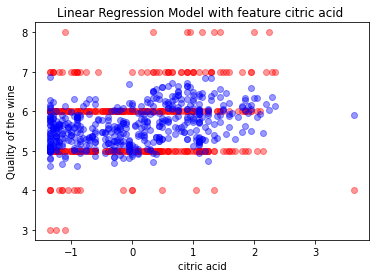

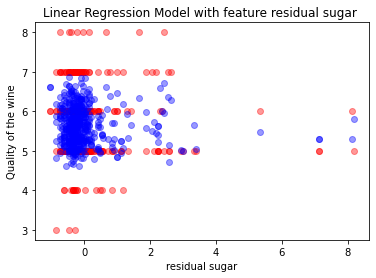

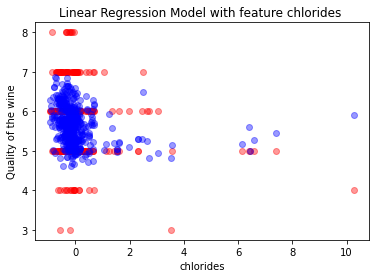

...

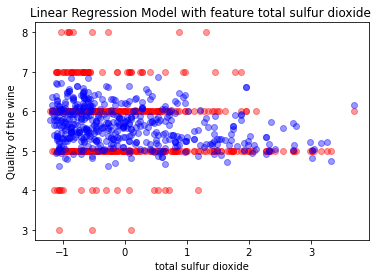

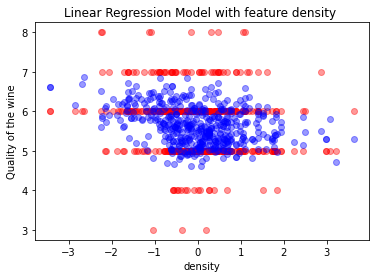

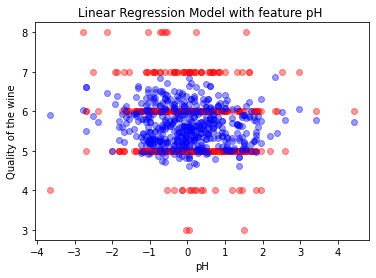

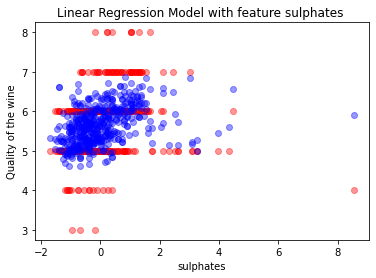

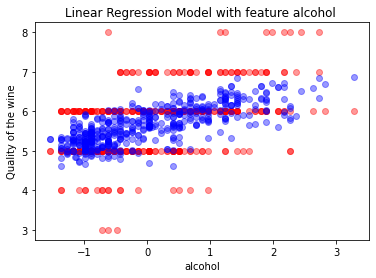

In [94]:
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred1, color='blue', alpha=0.4) #Predicted data
  #plt.plot(X_test[feature], y_pred,color= "black")
  plt.title("Linear Regression Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Quality of the wine')
  plt.show();


for feature in wine_feature_names :
   if feature != "bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [95]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred1)

0.3624270214842018

In [96]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_pred1,y_test)

0.42769413744569323

# ***Weather***

# Khai báo thư viện 


In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go

from collections import Counter


# Tải và kiểm tra dữ liệu

In [98]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [99]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [100]:
weather = pd.read_csv('./weather.csv')
type(weather)
weather.describe

<bound method NDFrame.describe of       Temperature_c  Humidity  ...  Rain  Description
0         -0.555556      0.92  ...     0         Cold
1         21.111111      0.73  ...     1         Warm
2         16.600000      0.97  ...     1       Normal
3          1.600000      0.82  ...     1         Cold
4          2.194444      0.60  ...     1         Cold
...             ...       ...  ...   ...          ...
9995      10.022222      0.95  ...     1       Normal
9996       8.633333      0.64  ...     1       Normal
9997       5.977778      0.93  ...     1       Normal
9998       9.788889      0.78  ...     1       Normal
9999      11.138889      0.79  ...     1       Normal

[10000 rows x 8 columns]>

In [101]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         10000 non-null  float64
 1   Humidity              10000 non-null  float64
 2   Wind_Speed_kmh        10000 non-null  float64
 3   Wind_Bearing_degrees  10000 non-null  int64  
 4   Visibility_km         10000 non-null  float64
 5   Pressure_millibars    10000 non-null  float64
 6   Rain                  10000 non-null  int64  
 7   Description           10000 non-null  object 
dtypes: float64(5), int64(2), object(1)
memory usage: 625.1+ KB


In [102]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), weather.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [103]:
weather.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [104]:
a= []
for c in weather :
  a.append(c)
print(a)

['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description']


Mô tả mối liên hệ giữa các thuộc tính của bảng

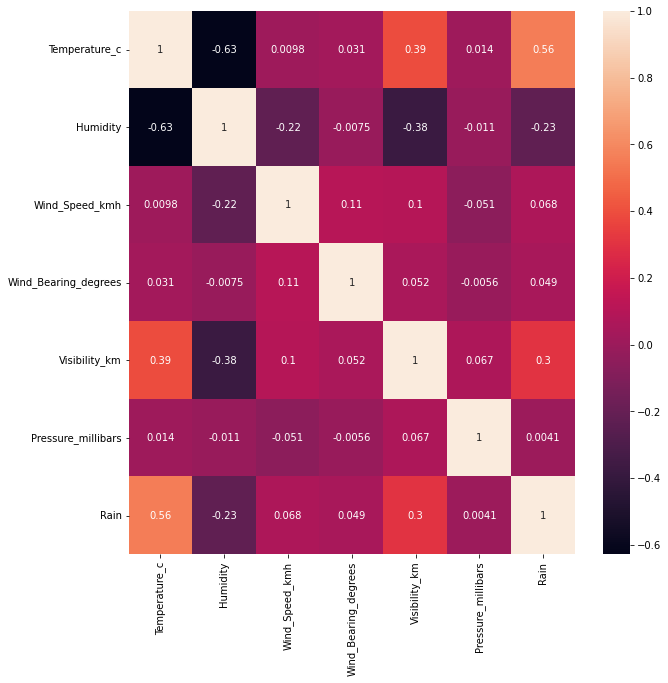

In [105]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(weather[['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description']].corr(), annot = True)
plt.show()

Qua đây ta thấy Rain có tương quan cao nhất với Temperature, các trường dữ liệu Wind_Bearing_degrees, Pressure_millibars thì có tương quan rất thấp nhất với Temperature với thấp với các trường dữ liệu còn lại. 

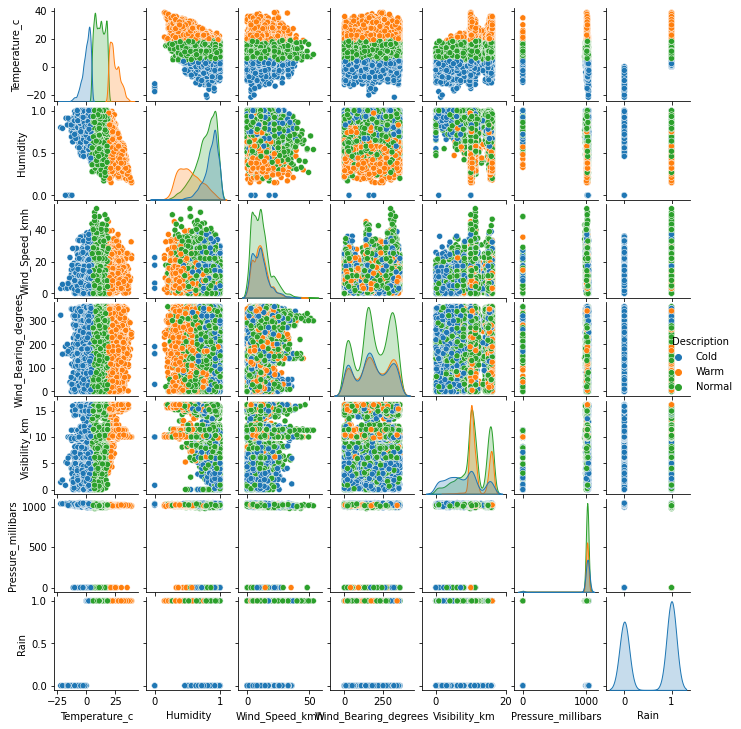

In [106]:
g = sns.pairplot(weather, kind='scatter', hue='Description')
g.fig.set_size_inches(10,10)

In [107]:
print(weather['Description'].unique())
weather['Description'] = LabelEncoder().fit_transform(weather['Description']) 
print(weather['Description'].unique())

['Cold' 'Warm' 'Normal']
[0 2 1]


In [108]:
sp = weather['Description'].value_counts()
sp = pd.DataFrame(sp)
sp

,Description
1,4992
2,2507
0,2501


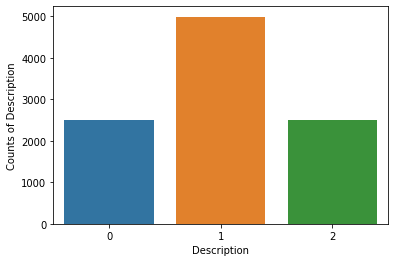

In [109]:
sns.barplot(x=sp.index, y=sp['Description']);
plt.xlabel('Description')
plt.ylabel('Counts of Description')
plt.show()

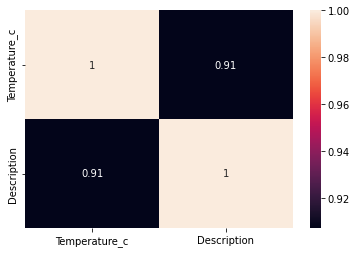

In [110]:
sns.heatmap(weather[['Temperature_c',  'Description']].corr(), annot = True)


Ta nhận thấy Description cho ra tương quan rất cao với Temperature. Đây là tín hiệu khả quan để ta train được kết quả tốt :))

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [111]:
def detect_outliers(df,features):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [112]:
x = detect_outliers(weather,['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description'])
new_weather = weather.loc[x]
print(new_weather.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4 entries, 4181 to 7416
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         4 non-null      float64
 1   Humidity              4 non-null      float64
 2   Wind_Speed_kmh        4 non-null      float64
 3   Wind_Bearing_degrees  4 non-null      int64  
 4   Visibility_km         4 non-null      float64
 5   Pressure_millibars    4 non-null      float64
 6   Rain                  4 non-null      int64  
 7   Description           4 non-null      int64  
dtypes: float64(5), int64(3)
memory usage: 288.0 bytes
None


In [113]:
new_weather.style.background_gradient(cmap='viridis')

,Temperature_c,Humidity,Wind_Speed_kmh,Wind_Bearing_degrees,Visibility_km,Pressure_millibars,Rain,Description
4181,-17.294444,0.910000,3.638600,161,5.200300,1035.900000,0,0
4526,-17.777778,0.000000,3.220000,190,0.805000,1035.000000,0,0
4975,-5.050000,0.540000,33.214300,20,9.982000,1041.250000,0,0
7416,-1.111111,0.750000,27.080200,150,11.205600,0.000000,0,0


In [114]:
weather = weather.drop(x)


In [115]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9996 entries, 0 to 9999
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         9996 non-null   float64
 1   Humidity              9996 non-null   float64
 2   Wind_Speed_kmh        9996 non-null   float64
 3   Wind_Bearing_degrees  9996 non-null   int64  
 4   Visibility_km         9996 non-null   float64
 5   Pressure_millibars    9996 non-null   float64
 6   Rain                  9996 non-null   int64  
 7   Description           9996 non-null   int64  
dtypes: float64(5), int64(3)
memory usage: 702.8 KB


In [116]:
weather_feature_names = ['Bias','Humidity', 'Wind_Speed_kmh', 'Visibility_km', 'Rain', 'Description']
#fish_feature_names = fish.columns[2:].values.tolist()
print(len(weather_feature_names))
print(weather_feature_names)

6
['Bias', 'Humidity', 'Wind_Speed_kmh', 'Visibility_km', 'Rain', 'Description']


#Tiến hành train dữ liệu

In [117]:
X = weather.drop(columns=['Temperature_c','Pressure_millibars','Wind_Bearing_degrees'])
y = weather['Temperature_c']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]

X_train = pd.DataFrame(X_train, columns = weather_feature_names)
X_test = pd.DataFrame(X_test, columns = weather_feature_names)
#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)
#print(X_train)
#print(X_test)

      Bias  Humidity  Wind_Speed_kmh  Visibility_km      Rain  Description
0      1.0 -0.695996        0.777726      -0.016067  0.344680     1.413121
1      1.0  0.842397       -0.635428       0.304104  0.344680    -0.004864
2      1.0 -1.157515        0.710762       1.307052  0.344680     1.413121
3      1.0 -2.080551       -0.501502      -0.016067  0.344680     1.413121
4      1.0  0.791117       -0.633119       1.133465  0.344680    -0.004864
...    ...       ...             ...            ...       ...          ...
6992   1.0 -1.670312       -0.859409       1.361056  0.344680    -0.004864
6993   1.0  0.637278        0.031894      -0.158794 -2.901246    -1.422848
6994   1.0  0.739838       -1.108789      -1.559063 -2.901246    -1.422848
6995   1.0  1.355195        0.059603      -2.419283  0.344680    -1.422848
6996   1.0  1.355195       -1.094934      -1.794370  0.344680    -1.422848

[6997 rows x 6 columns]
      Bias  Humidity  Wind_Speed_kmh  Visibility_km      Rain  Description


In [118]:
X1 = X_train.to_numpy()
X2 = X_test.to_numpy()
y1 = y_train.to_numpy()
y2 = y_test.to_numpy()
#print(X1)

[[ 1.         -0.69599647  0.77772565 -0.01606727  0.34467951  1.41312065]
 [ 1.          0.84239707 -0.63542828  0.30410434  0.34467951 -0.00486375]
 [ 1.         -1.15751454  0.71076247  1.30705154  0.34467951  1.41312065]
 ...
 [ 1.          0.7398375  -1.10878867 -1.55906296 -2.90124585 -1.42284814]
 [ 1.          1.35519492  0.05960331 -2.41928306  0.34467951 -1.42284814]
 [ 1.          1.35519492 -1.09493422 -1.7943698   0.34467951 -1.42284814]]


In [119]:
#Cách 1:
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X1,y1)
print(beta1)

[11.89277548 -1.74590464 -0.55984698  0.1657439   1.54219045  6.72783458]


In [120]:
#Cách 2:
Xt = np.transpose(X1)
XtX = np.dot(Xt,X1)
Xty = np.dot(Xt,y1)
beta2 = np.linalg.solve(XtX,Xty)
print(beta2)

[11.89277548 -1.74590464 -0.55984698  0.1657439   1.54219045  6.72783458]


In [121]:
# Cách 3: Kiểm chứng
from sklearn.linear_model import LinearRegression
reg = LinearRegression(fit_intercept=False).fit(X_train, y_train)
beta3 = reg.coef_
print(beta3)


[11.89277548 -1.74590464 -0.55984698  0.1657439   1.54219045  6.72783458]


In [122]:
y_pred1 = np.dot(X2,beta1)
print(y_pred1)
print(len(y_pred1))

[23.76718722 12.82067491 10.8852588  ... 24.54485996 12.64546852
 22.07457674]
2999


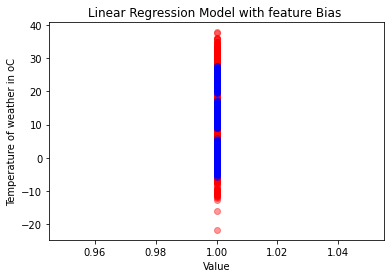

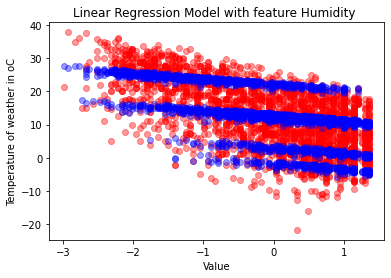

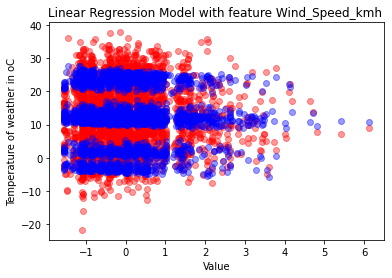

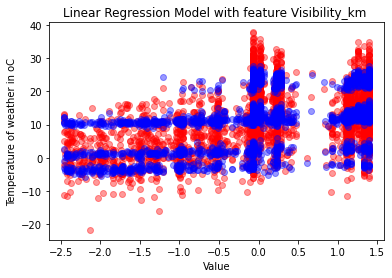

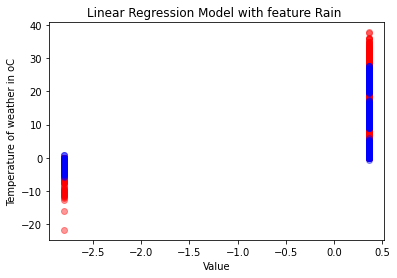

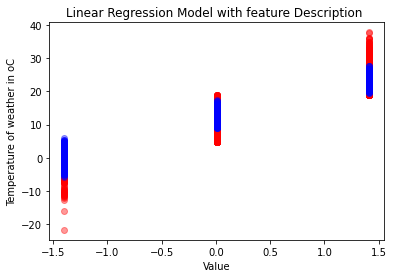

In [123]:
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred1, color='blue', alpha=0.4) #Predicted data
  #plt.plot(X_test[feature], y_pred,color= "black")
  plt.title("Linear Regression Model with feature {} ".format(feature))
  plt.xlabel('Value')
  plt.ylabel('Temperature of weather in oC')
  plt.show();


for feature in weather_feature_names :
   if feature != "bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [124]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred1)

0.8684013709174712

In [125]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_pred1,y_test)

12.19481828693935